In [1]:
import os
import numpy as np
import pandas as pd
from scroutines.config_plots import *

In [2]:
ddir = '/data/qlyu/v1/data/easifish/lt185/r1/proc'
n5dir = '/data/qlyu/v1/data/easifish/lt185/r1/stitching/export.n5'
f1 = os.path.join(ddir, 'roi.csv')
f2 = os.path.join(ddir, 'spotcount_intn.csv')

In [3]:
df1 = pd.read_csv(f1, index_col=0)
df2 = pd.read_csv(f2, index_col=0)
df  = df1.join(df2)

In [4]:
df

,z,y,x,area,r1_c0,r1_c2
roi,,,,,,
1,230.389598,56.437039,238.983970,501.860184,1.769015,1.156686
2,237.700152,162.113172,37.984626,445.693080,2.072358,0.545858
3,217.410027,44.451470,157.786285,487.818408,1.683522,0.000000
4,222.032311,71.949279,48.363161,398.057688,1.229783,0.000000
5,243.534250,90.076493,84.211826,430.318224,2.490759,0.000000
...,...,...,...,...,...,...
43807,160.479014,200.839714,412.101986,248.752728,0.617888,0.095640
43808,87.607758,143.106929,315.862485,87.983280,0.174100,0.826066
43809,94.403970,108.749933,335.730268,106.113168,0.000000,0.082190


In [5]:
cond = df['area'] < 1500
df = df[cond]

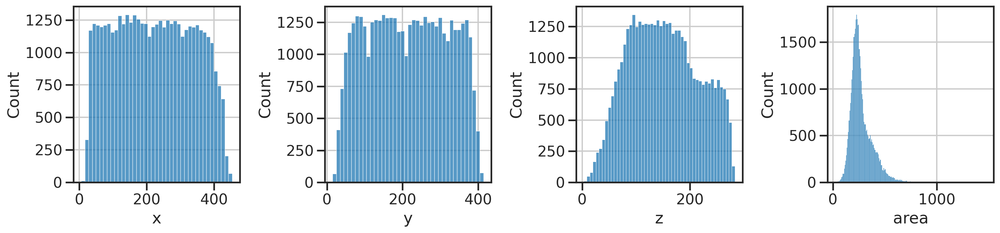

In [6]:
# cell level stats
fig, axs = plt.subplots(1,4,figsize=(4*4,1*4))
ax = axs[0]
sns.histplot(df['x'].values, ax=ax)
ax.set_xlabel('x')
ax = axs[1]
sns.histplot(df['y'].values, ax=ax)
ax.set_xlabel('y')
ax = axs[2]
sns.histplot(df['z'].values, ax=ax)
ax.set_xlabel('z')
ax = axs[3]
sns.histplot(df['area'].values, ax=ax)
ax.set_xlabel('area')
fig.tight_layout()
plt.show()

In [7]:
channels = [
    'r1_c0',  'r1_c2',
]
genes = [
    'RL (Cre)',
    'LM (FlpO)',
]

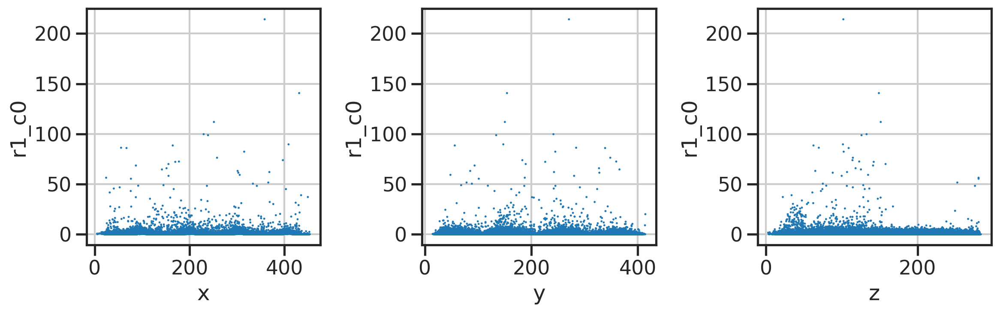

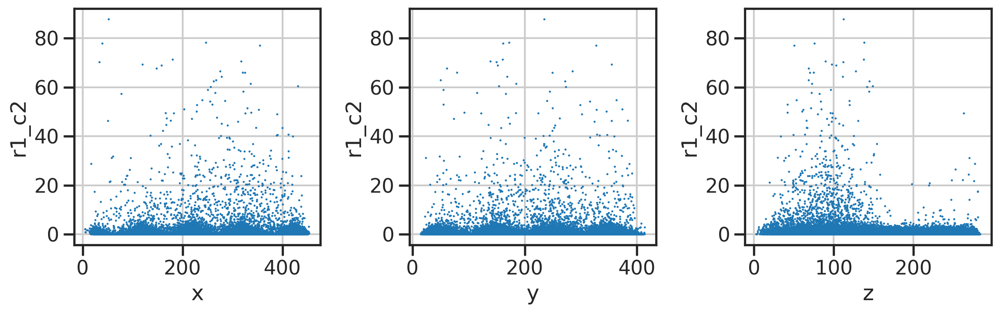

In [8]:
# cell level stats
for ch in channels: 
    fig, axs = plt.subplots(1,3,figsize=(3*4,1*4))
    ax = axs[0]
    sns.scatterplot(data=df, x='x', y=ch, ax=ax, s=3, edgecolor='none')
    ax.set_xlabel('x')

    ax = axs[1]
    sns.scatterplot(data=df, x='y', y=ch, ax=ax, s=3, edgecolor='none')
    ax.set_xlabel('y')

    ax = axs[2]
    sns.scatterplot(data=df, x='z', y=ch, ax=ax, s=3, edgecolor='none')
    ax.set_xlabel('z')

    fig.tight_layout()
    plt.show()

In [9]:
df.describe()

,z,y,x,area,r1_c0,r1_c2
count,43780.000000,43780.000000,43780.000000,43780.000000,43780.000000,43780.000000
mean,151.349004,214.692004,221.729586,273.880933,0.837488,0.765060
std,63.914042,103.534526,114.743845,109.062291,2.744456,2.886542
min,2.905525,14.598908,5.242453,21.862512,0.000000,0.000000
25%,100.020877,126.587595,123.396525,204.761088,0.000000,0.000000
50%,148.281205,215.795621,220.924602,247.153032,0.290070,0.062589
75%,199.689785,302.871813,319.757731,320.672394,1.038469,0.773652
max,283.616841,414.296623,453.564618,1476.341664,214.218551,87.684310


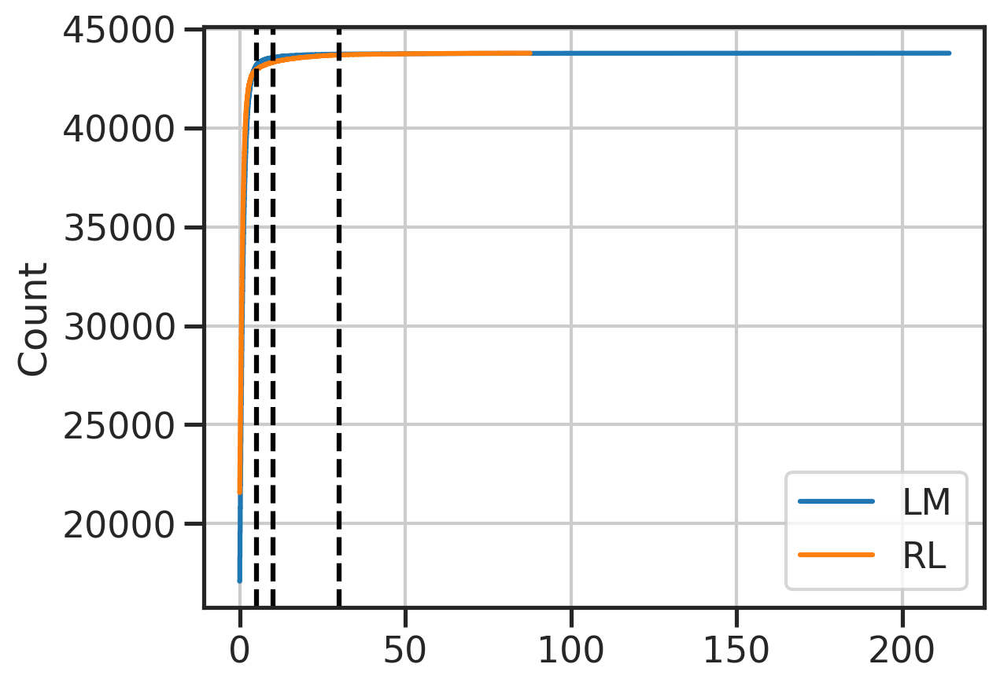

In [10]:
fig, ax = plt.subplots()
sns.histplot(df['r1_c0'].values, cumulative=True, element='step', fill=False, label='LM', ax=ax)
sns.histplot(df['r1_c2'].values, cumulative=True, element='step', fill=False, label='RL', ax=ax)
ax.axvline(5, linestyle='--', color='k')
ax.axvline(10, linestyle='--', color='k')
ax.axvline(30, linestyle='--', color='k')
ax.legend()

33.18746463584247


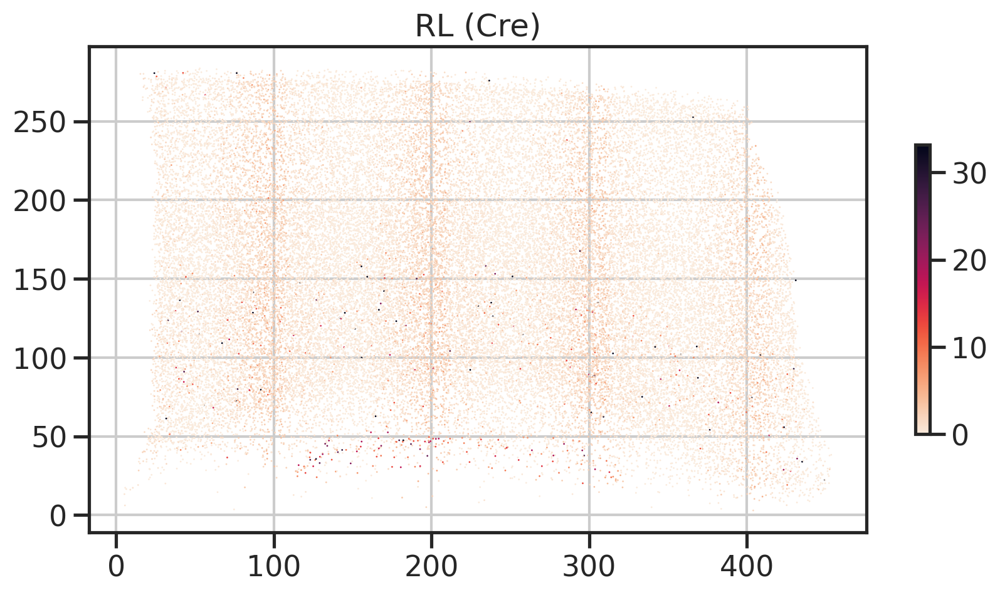

44.69253687206995


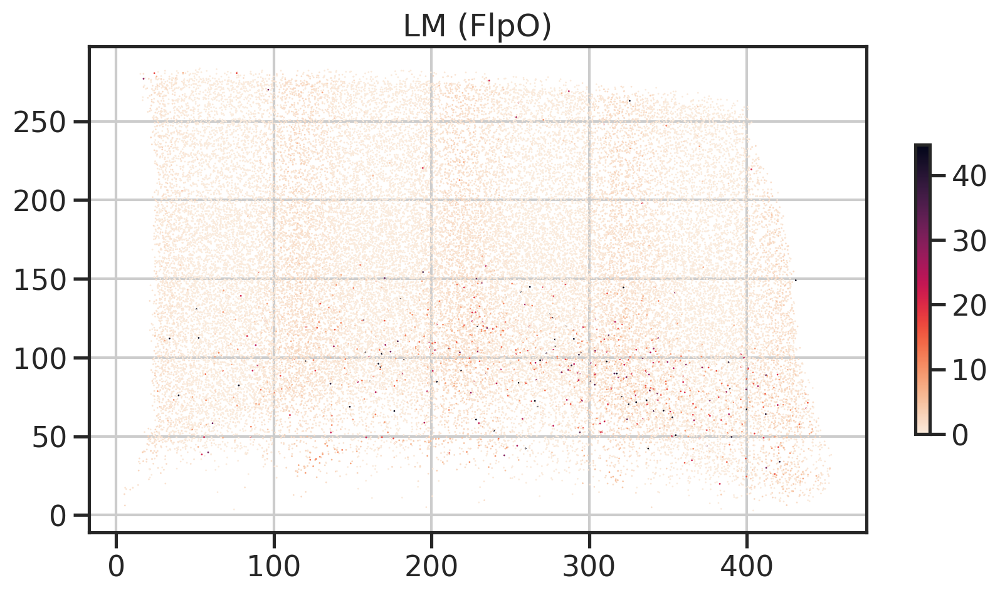

In [11]:
for ch, gene in zip(channels, genes):
    fig, ax = plt.subplots(figsize=(10,10))
    vmax = np.percentile(df[f'{ch}'], 99.9)
    print(vmax)
    g = ax.scatter(df['x'].values, df['z'].values, c=df[f'{ch}'], s=1, edgecolor='none', 
                   vmax = vmax,
               cmap='rocket_r')
    ax.set_title(gene)
    ax.set_aspect('equal')
    fig.colorbar(g, shrink=0.3)
    plt.show()

In [12]:
def rename(code):
    rename_dict = {
        0: 'NA', 
        1: 'RL', 
        2: 'LM', 
        3: 'both'}
    return rename_dict[code]

df = df.copy()
th = 10 
df['bi_r1_c0'] = df['r1_c0'] > th
df['bi_r1_c2'] = df['r1_c2'] > th 
df['lbl'] = (df['r1_c0'] > th).astype(int) + 2*(df['r1_c2'] > th).astype(int)
df['lbl_v2'] = df['lbl'].apply(rename)
np.unique(df['lbl'].values)
np.unique(df['lbl_v2'].values)

array(['LM', 'NA', 'RL', 'both'], dtype=object)

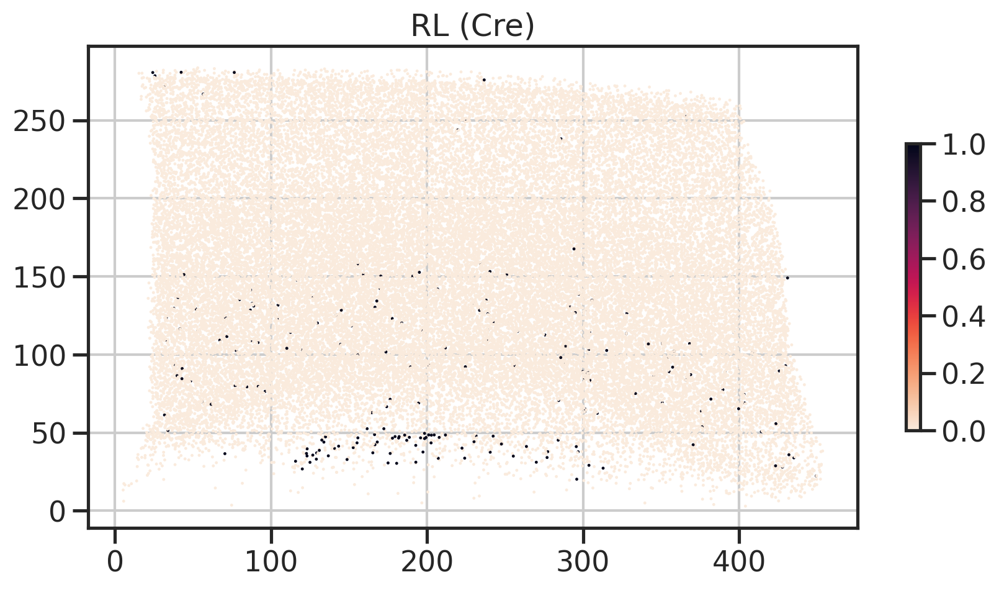

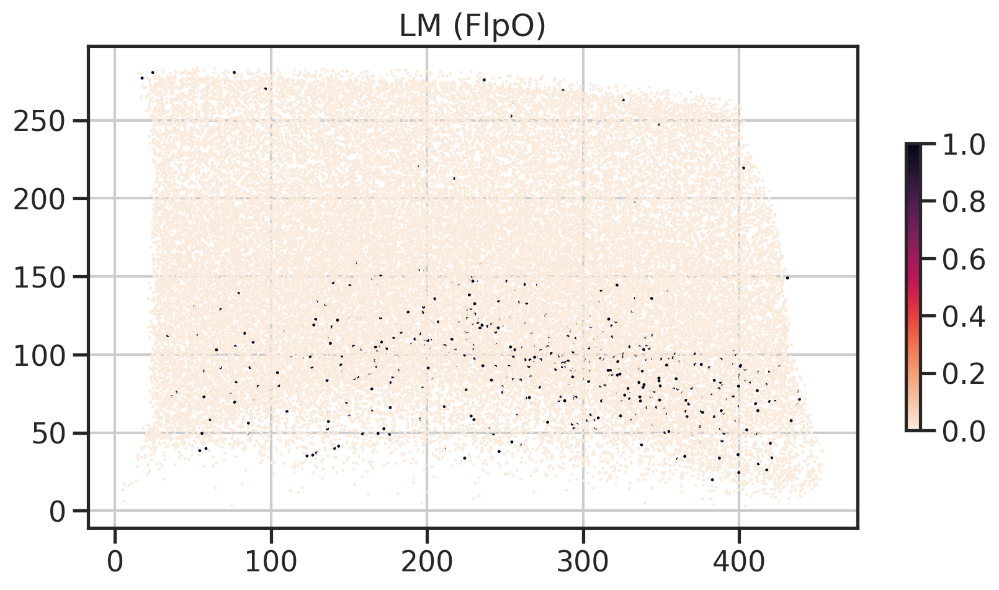

In [13]:
for ch, gene in zip(channels, genes):
    
    fig, ax = plt.subplots(figsize=(10,10))
    g = ax.scatter(df['x'].values, df['z'].values, c=df[f'bi_{ch}'], s=3, edgecolor='none', 
               cmap='rocket_r')
    ax.set_title(gene)
    ax.set_aspect('equal')
    fig.colorbar(g, shrink=0.3)
    plt.show()

In [14]:
sns.color_palette('tab10', 10)

[(0.12156862745098039, 0.4666666666666667, 0.7058823529411765),
 (1.0, 0.4980392156862745, 0.054901960784313725),
 (0.17254901960784313, 0.6274509803921569, 0.17254901960784313),
 (0.8392156862745098, 0.15294117647058825, 0.1568627450980392),
 (0.5803921568627451, 0.403921568627451, 0.7411764705882353),
 (0.5490196078431373, 0.33725490196078434, 0.29411764705882354),
 (0.8901960784313725, 0.4666666666666667, 0.7607843137254902),
 (0.4980392156862745, 0.4980392156862745, 0.4980392156862745),
 (0.7372549019607844, 0.7411764705882353, 0.13333333333333333),
 (0.09019607843137255, 0.7450980392156863, 0.8117647058823529)]

In [15]:
palette = {
    'NA': 'lightgray', 
    'LM': 'C3', 
    'RL': 'C0', 
    'both': 'C6', 
}

In [16]:
df.value_counts('lbl_v2')

lbl_v2
NA      43107
LM        451
RL        205
both       17
dtype: int64

In [49]:
a = df.value_counts('lbl_v2')
print(a/len(df)*100, "\n")

print(f"both in LM (%): {a.loc['both']/(a.loc['both']+a.loc['LM'])*100:.1f}")
print(f"both in RL (%): {a.loc['both']/(a.loc['both']+a.loc['RL'])*100:.1f}")
print(f"RL/LM (%): {(a.loc['both']+a.loc['RL'])/(a.loc['both']+a.loc['LM'])*100:.1f}")

lbl_v2
NA      98.462768
LM       1.030151
RL       0.468250
both     0.038831
dtype: float64 

both in LM (%): 3.6
both in RL (%): 7.7
RL/LM (%): 47.4


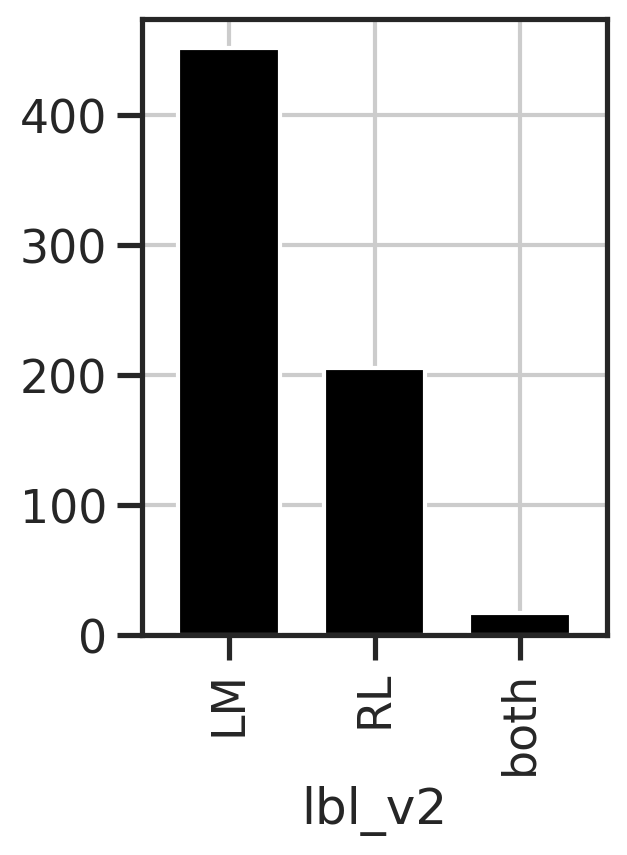

In [18]:
fig, ax = plt.subplots(figsize=(3,4))
df[df['lbl_v2']!='NA'].value_counts('lbl_v2').plot.bar(width=0.7, color='black')
plt.show()

In [19]:
def plot_easifish_proj(data, x, y, hue='lbl_v2', na_rep='NA', invert_yaxis=False, figsize=(8,8)):
    
    fig, ax = plt.subplots(figsize=figsize)
    sns.scatterplot(data=df, 
                    x=x, y=y, color='lightgray', s=2, edgecolor='none')
    sns.scatterplot(data=df[df[hue]!=na_rep], 
                    x=x, y=y, hue=hue, palette=palette, s=5, edgecolor='none')
    if invert_yaxis:
        ax.invert_yaxis()
        
    ax.grid(False)
    ax.set_aspect('equal')
    ax.legend(bbox_to_anchor=(1,1))
    plt.show()

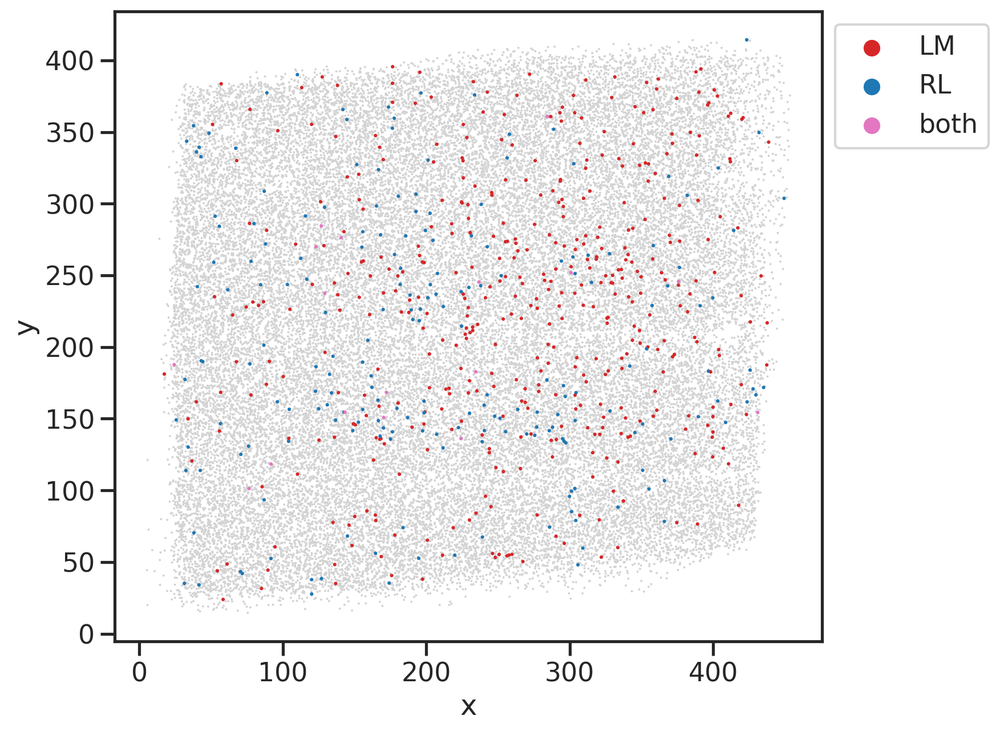

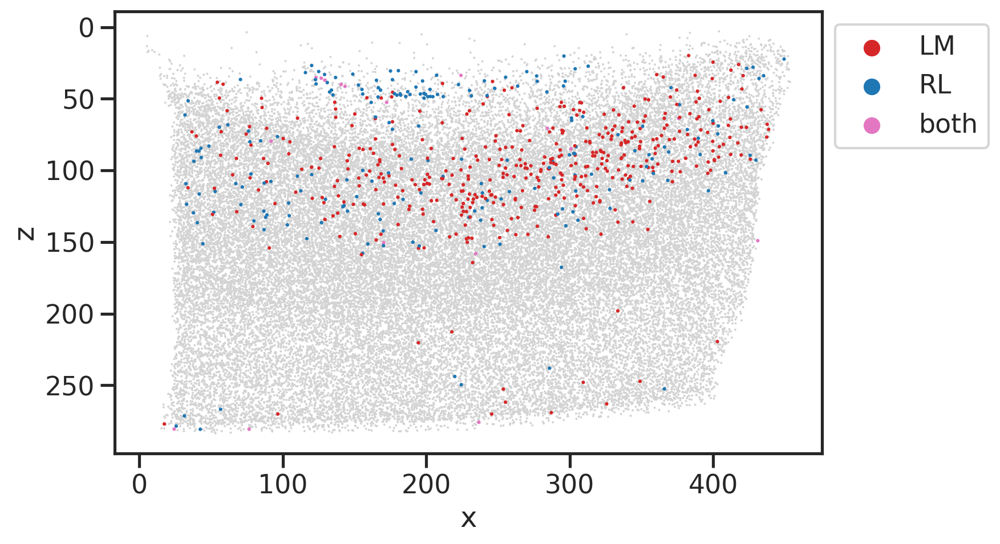

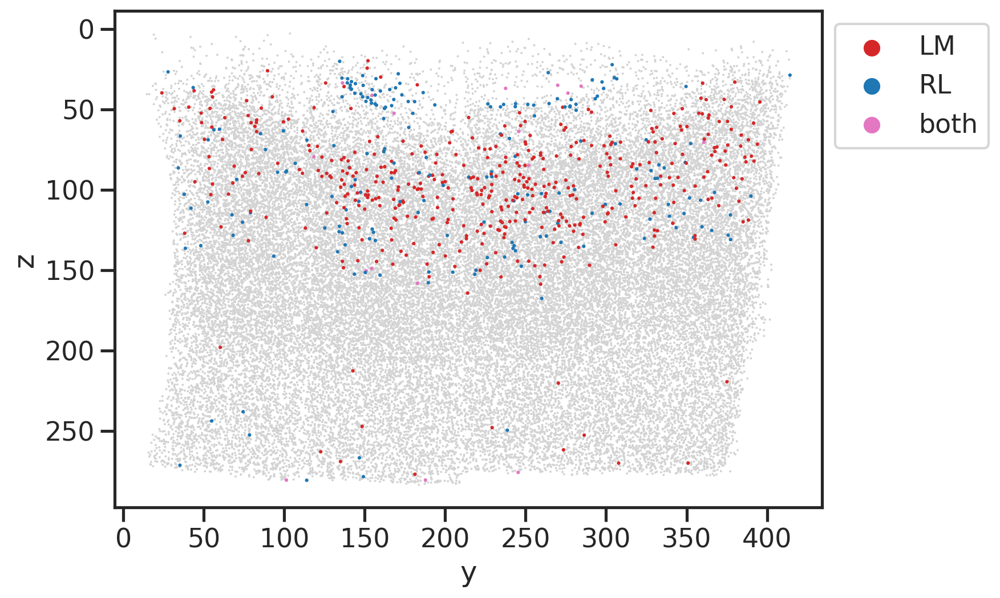

In [20]:
plot_easifish_proj(df, 'x', 'y')
plot_easifish_proj(df, 'x', 'z', invert_yaxis=True)
plot_easifish_proj(df, 'y', 'z', invert_yaxis=True)

# check dimensions - make sure I understand them

#### Load 'n5' image data - cytoDAPI

In [21]:
import zarr

In [22]:
subpath='c3/s3' # channel and scale, full resolution (s0) image can be loaded for detailed inspection
im = zarr.open(store=zarr.N5Store(n5dir), mode='r')
img = im[subpath] ## can also choose to load a subset of the image data
img.shape # z, y, x

(730, 913, 1136)

In [23]:
img = img[:,:,:]

In [24]:
np.percentile(img, [0,5,50,95, 99, 99.5, 100])

array([   86.,    89.,    91.,   116.,   165.,   194., 11649.])

89.0 146.0


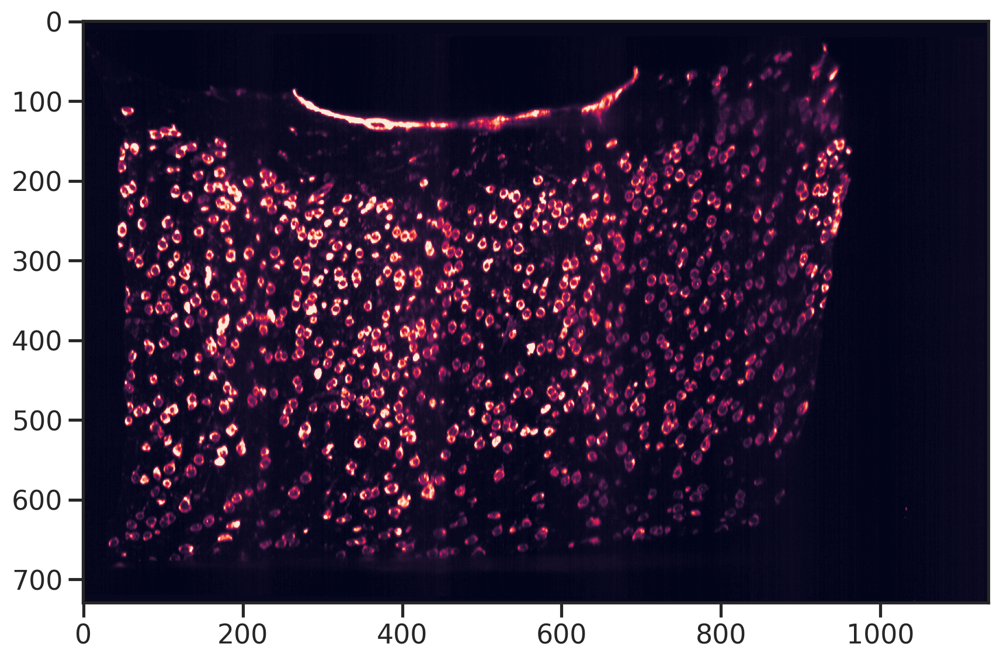

In [25]:
img2d = img[:,400,:]
vmin, vmax = np.percentile(img2d, [5,99])
print(vmin, vmax)

fig, ax = plt.subplots(figsize=(10,8))
g = ax.imshow(img2d, vmin=vmin, vmax=vmax, cmap='rocket')
ax.grid(False)
# ax.axis('off')
ax.set_aspect('equal')
# fig.colorbar(g, shrink=0.3)
plt.show()

89.0 112.0


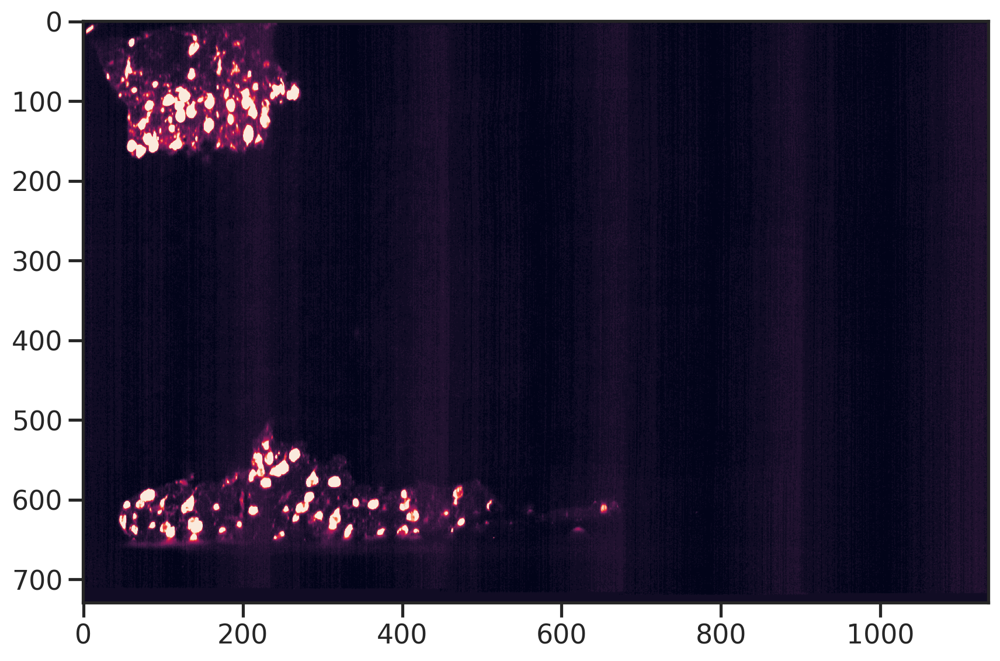

89.0 126.0


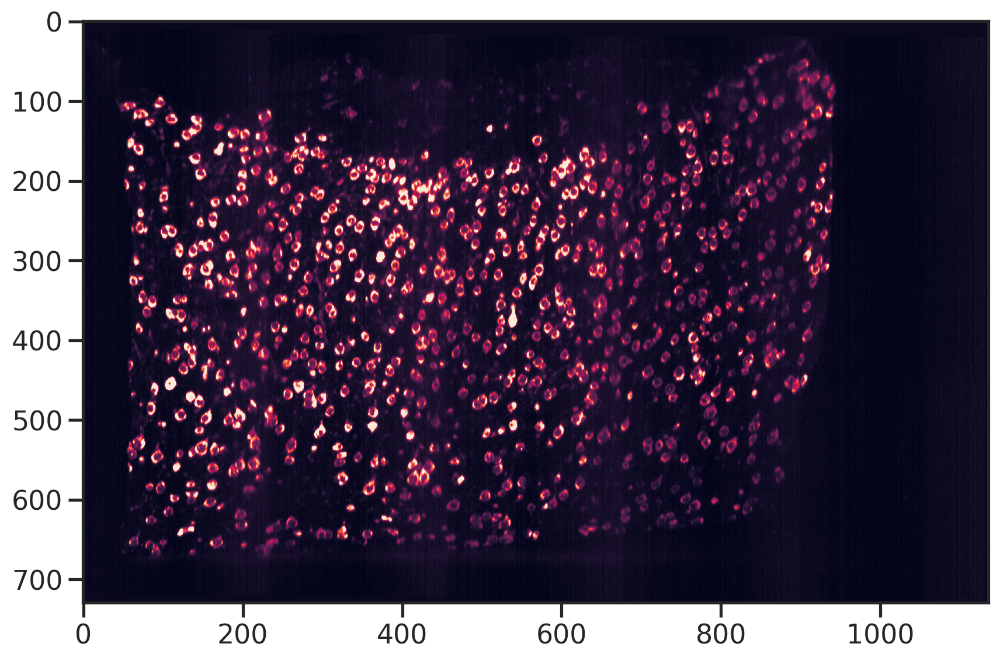

89.0 118.0


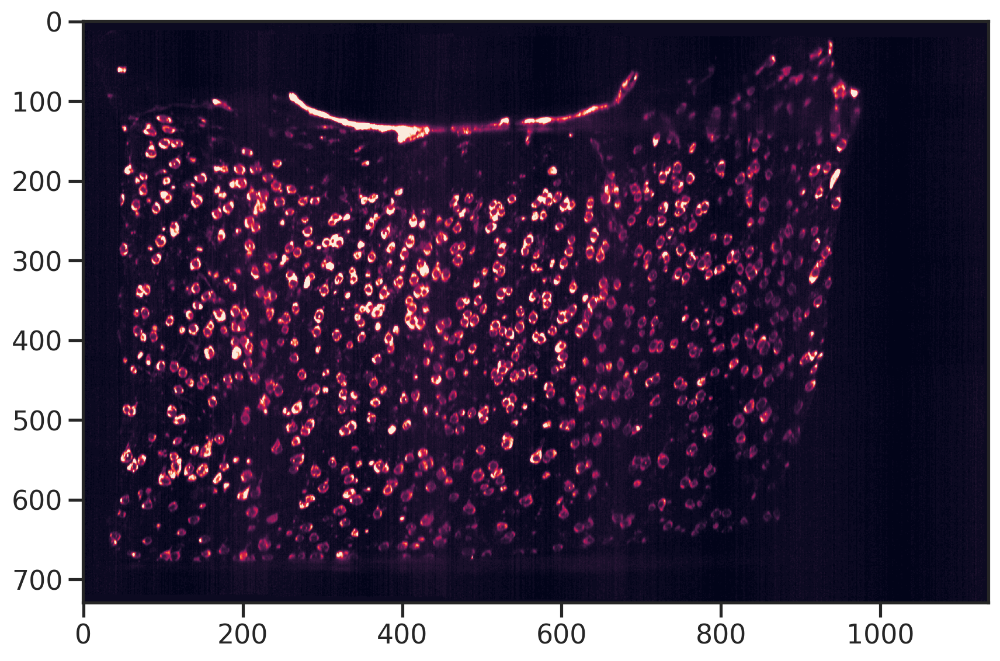

89.0 141.0


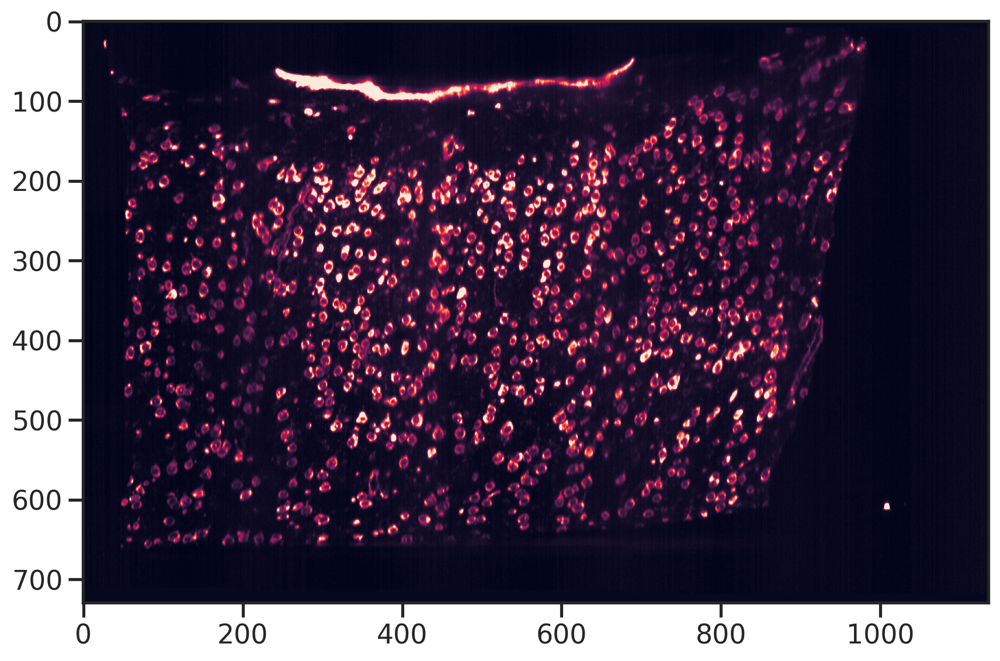

89.0 116.0


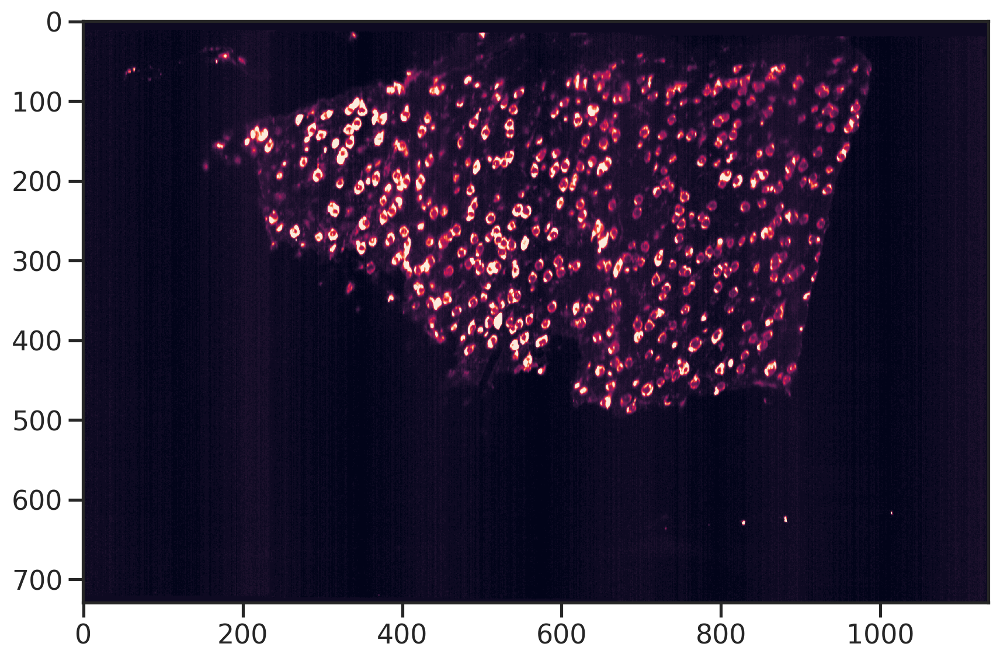

In [26]:
for cut in np.arange(50,900,200):
    img2d = img[:,cut,:]
    vmin, vmax = np.percentile(img2d, [5,99])
    print(vmin, vmax)

    fig, ax = plt.subplots(figsize=(10,8))
    g = ax.imshow(img2d, vmin=vmin, vmax=vmax, cmap='rocket')
    ax.grid(False)
    # ax.axis('off')
    ax.set_aspect('equal')
    # fig.colorbar(g, shrink=0.3)
    plt.show()

89.0 146.0


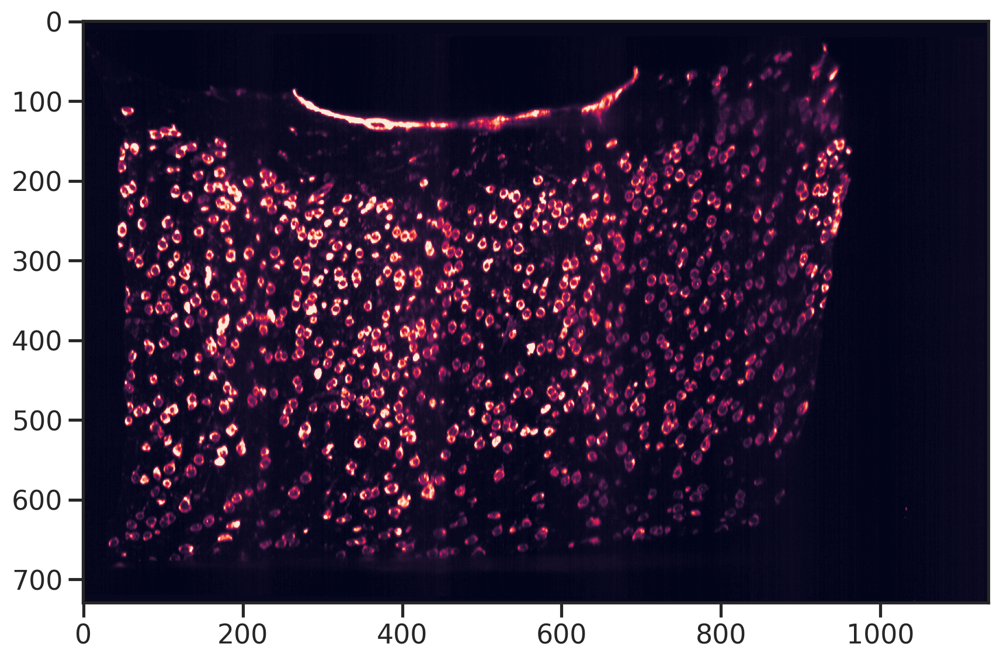

In [27]:
img2d = img[:,400,:]
vmin, vmax = np.percentile(img2d, [5,99])
print(vmin, vmax)

fig, ax = plt.subplots(figsize=(10,8))
g = ax.imshow(img2d, vmin=vmin, vmax=vmax, cmap='rocket')
ax.grid(False)
# ax.axis('off')
ax.set_aspect('equal')
# fig.colorbar(g, shrink=0.3)
plt.show()

89.0 172.0


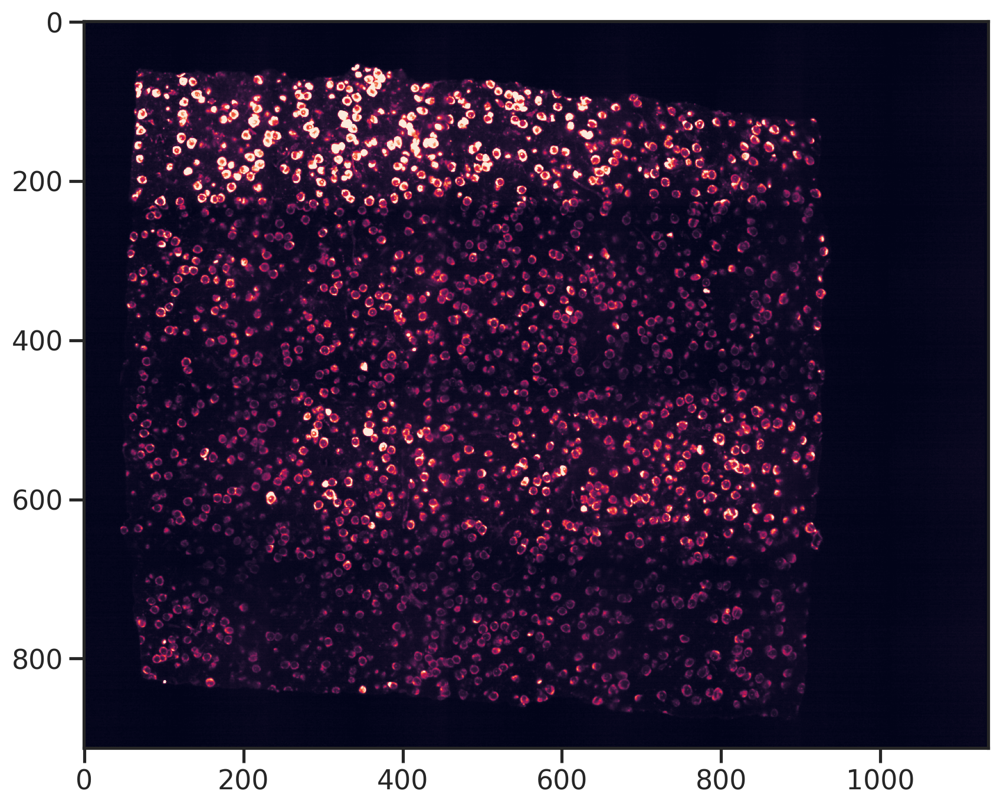

In [28]:
img2d = img[400,:,:]
vmin, vmax = np.percentile(img2d, [5,99])
print(vmin, vmax)

fig, ax = plt.subplots(figsize=(10,8))
g = ax.imshow(img2d, vmin=vmin, vmax=vmax, cmap='rocket')
ax.grid(False)
# ax.axis('off')
ax.set_aspect('equal')
# fig.colorbar(g, shrink=0.3)
plt.show()

In [29]:
subpath0='c0/s3' # channel and scale, full resolution (s0) image can be loaded for detailed inspection
img0 = im[subpath0] ## can also choose to load a subset of the image data
img0 = img0[:,:,:]
np.percentile(img0, [0,5,50,95, 99, 99.5, 100])

array([  86.,   89.,   90.,   91.,   92.,   93., 8559.])

91.0 8559.0


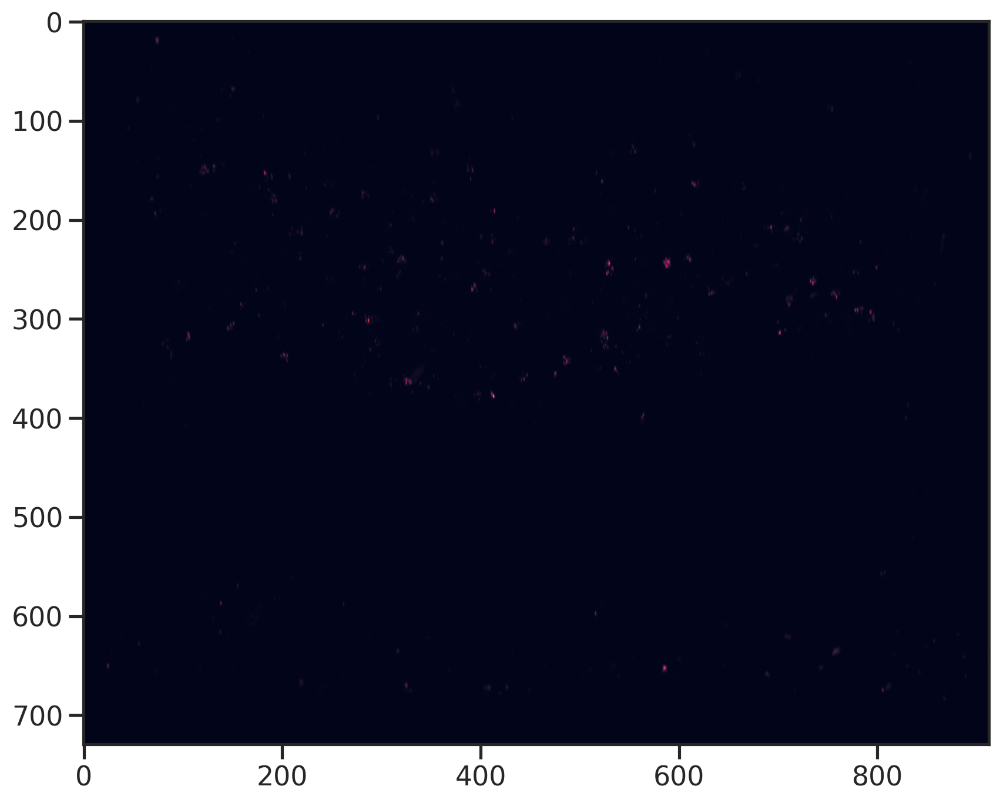

In [30]:
img2d = np.max(img0[:,:,:], axis=2)
vmin, vmax = np.percentile(img2d, [5,100])
print(vmin, vmax)

fig, ax = plt.subplots(figsize=(10,8))
g = ax.imshow(img2d, vmin=vmin, vmax=vmax, cmap='rocket')
ax.grid(False)
# ax.axis('off')
ax.set_aspect('equal')
# fig.colorbar(g, shrink=0.3)
plt.show()

In [31]:
subpath0='c2/s3' # channel and scale, full resolution (s0) image can be loaded for detailed inspection
img0 = im[subpath0] ## can also choose to load a subset of the image data
img0 = img0[:,:,:]
np.percentile(img0, [0,5,50,95, 99, 99.5, 100])

array([  86.,   89.,   90.,   91.,   92.,   92., 4079.])

91.0 4079.0


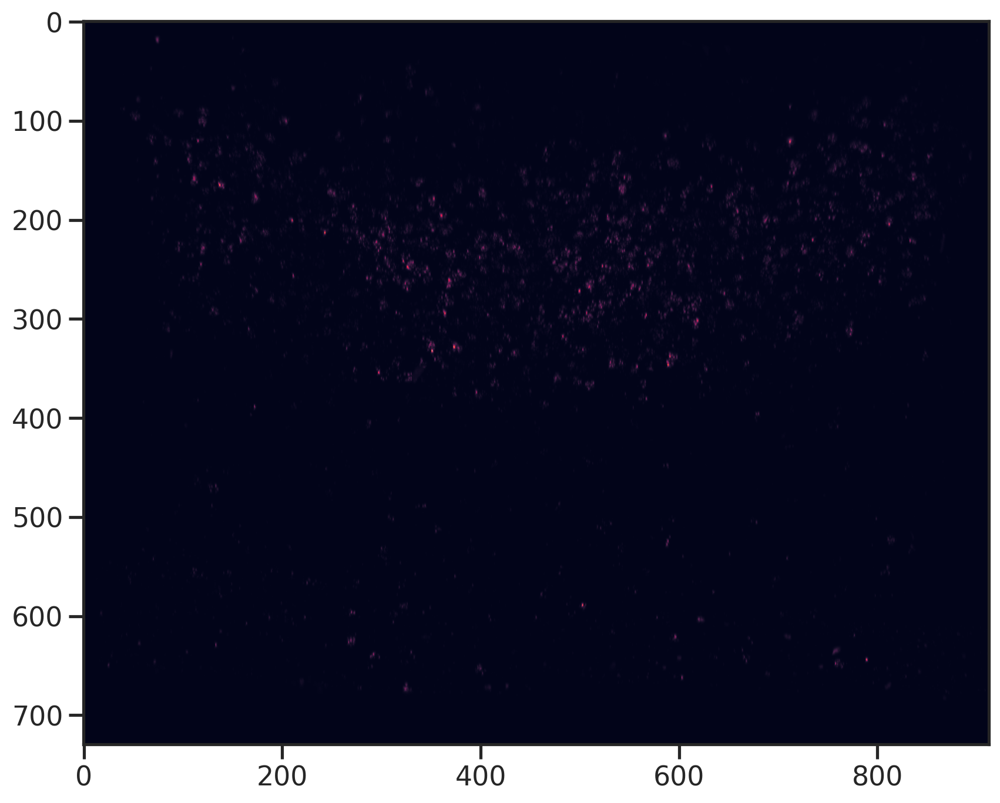

In [32]:
img2d = np.max(img0[:,:,:], axis=2)
vmin, vmax = np.percentile(img2d, [5,100])
print(vmin, vmax)

fig, ax = plt.subplots(figsize=(10,8))
g = ax.imshow(img2d, vmin=vmin, vmax=vmax, cmap='rocket')
ax.grid(False)
# ax.axis('off')
ax.set_aspect('equal')
# fig.colorbar(g, shrink=0.3)
plt.show()